In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import keras
from warnings import filterwarnings
filterwarnings('ignore')
import os
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
from nltk import word_tokenize
import time
import string
import re

# File Load

In [2]:
file="Reviews.csv"
data= pd.read_csv(file)
print(data.shape)

(334119, 31)


In [3]:
data.describe()

,Unnamed: 0,ï»¿,ratings_overall,labels,likeCount,latitude,longitude,primary_cuisine_id,review_number,restaurant_overall_rating
count,334119.000000,334119.000000,334119.000000,334119.000000,334119.000000,334119.000000,334119.000000,334119.000000,334119.000000,334119.000000
mean,167059.000000,168411.559947,2.817562,1.916958,0.241884,23.668077,90.623229,127.527136,4014.909981,3.841418
std,96451.991633,96817.799309,1.684886,0.935649,0.629411,0.528833,0.528335,54.243513,5812.797803,0.445709
min,0.000000,0.000000,1.000000,1.000000,-2.000000,22.269991,90.210323,0.000000,0.000000,0.000000
25%,83529.500000,84763.500000,1.000000,1.000000,0.000000,23.741879,90.371986,85.000000,488.000000,3.600000
50%,167059.000000,168499.000000,3.000000,2.000000,0.000000,23.773776,90.405709,86.000000,1584.000000,3.900000
75%,250588.500000,252235.500000,5.000000,3.000000,0.000000,23.810406,90.425728,193.000000,4697.000000,4.100000
max,334118.000000,335947.000000,5.000000,3.000000,51.000000,24.919806,91.910593,249.000000,32993.000000,5.000000


# <h2> Max and Min Sentance Length</h2>

In [4]:
print('Number of Duplicates:', len(data[data.duplicated()]))
# data = data.drop_duplicates(keep="last")

Number of Duplicates: 0


In [5]:
print(len(max(data['text'],key=len)))
print(len(min(data['text'],key=len)))

366
3


# **NLP Processing** <a id="3"></a>

In [6]:
import nltk
stemmer = nltk.SnowballStemmer("english")
from nltk.corpus import stopwords
import string
stopword=set(stopwords.words('english'))
t = time.time()

def leadMyWord(text):
    text = text.lower()
    
    text = re.sub(r"don't", "do not", text)
    text = re.sub(r"don t", "do not", text)
    text = re.sub(r"didn't", "did not", text)
    text = re.sub(r"didn t", "did not", text)
    text = re.sub(r"won't", "will not", text)
    text = re.sub(r"won t", "will not", text)
    text = re.sub(r"isn't", "is not", text)
    text = re.sub(r"isn t", "is not", text)
    text = re.sub(r"aren't", "are not", text)
    text = re.sub(r"aren t", "are not", text)
    text = re.sub(r"wasn't", "was not", text)
    text = re.sub(r"wasn t", "was not", text)
    text = re.sub(r"weren't", "were not", text)
    text = re.sub(r"weren t", "were not", text)
    text = re.sub(r"haven't", "have not", text)
    text = re.sub(r"haven t", "have not", text)
    text = re.sub(r"hadn't", "had not", text)
    text = re.sub(r"hadn t", "had not", text)
    text = re.sub(r"couldn't", "could not", text)
    text = re.sub(r"couldn t", "could not", text)
    text = re.sub(r"shouldn't", "should not", text)
    text = re.sub(r"shouldn t", "should not", text)
    text = re.sub(r"can't", "can not", text)
    text = re.sub(r"can t", "can not", text)
    text = re.sub(r"it's", "it is", text)
    text = re.sub(r"it s", "it is", text)
    text = re.sub(r"kebab", "kabab", text)
    text = re.sub(r"nun", "naan", text)
    text = re.sub(r"nan", "naan", text)
    text = re.sub('[^a-zA-Z]'," ",text)
    
    text = re.sub('\[.*?\]', '', text)
    text = re.sub('<.*?>+', '', text)
    text = re.sub('[%s]' % re.escape(string.punctuation), '', text)
    text = re.sub('\n', '', text)
    text= re.sub('\s{2,}', ' ', text)
    text = re.sub('\w*\d\w*', '', text)
#     print(text)
    text = "".join(text)
#     text = [word for word in text.split() if word not in stopword]
# #     print(text,"f2nd")
#     text = " ".join(text)
#     print(text,"last")
    return text   
textList = data.text.apply(leadMyWord)
print("Before")
print(data["text"][2])
data['text'] = data.text.apply(leadMyWord)
# data['clean_data']=textList
textList = list(textList)
print("After")
print(textList[2])
print("Time Passed")
print(time.time()-t)

Before
food average but their desert booter halwa and pudding is very good
After
food average but their desert booter halwa and pudding is very good
Time Passed
23.272506713867188


In [7]:
unique_words = set(textList)

# Count the number of unique words
total_unique_words = len(unique_words)

print("Total unique words:", total_unique_words)

Total unique words: 261451


In [8]:
data.loc[1:15, ['text','reviewerName', 'ratings_overall','labels']]

,text,reviewerName,ratings_overall,labels
1,very small in amount,MOON,2,1
2,food average but their desert booter halwa and...,SALMAN,3,2
3,fresh and tasty,GOLAM,5,3
4,everything i ordered was good,FERZANA,4,3
5,kalo jira vhorta balu vhorta not recommended b...,FERZANA,1,1
6,quantity of dal should be little more otherwis...,FERZANA,4,3
7,beef was too poor in size quantity aganist pri...,DEDAR,3,2
8,chicken was not up to the mark and lotpoti was...,IFTEKHER,5,3
9,lot of sand in kali jeers bortha,MOHAMMAD,4,3
10,bad,MOHAMMAD,1,1


for i in range(200):
    print(textList[i])


for i in range(200):
    print(data["text"][i])

# Label encoding

In [9]:
#preparing y

from sklearn.preprocessing import LabelEncoder
from keras.utils import to_categorical

le = LabelEncoder()
labelEncode = le.fit_transform(data['ratings_overall'])
print("LabelEncode")
print(labelEncode)
categorical_y = to_categorical(labelEncode)
print("To_Categorical")
print(categorical_y)

LabelEncode
[1 1 2 ... 4 3 0]
To_Categorical
[[0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0.]
 ...
 [0. 0. 0. 0. 1.]
 [0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0.]]


# One hot encoding with padding

In [10]:
from keras.preprocessing.text import one_hot
from keras_preprocessing.sequence import pad_sequences


#preparing x for CNN
MAX_FEATURES = 48000

onehot_corpus = []
for text in textList:
#     print(text)
    onehot_corpus.append(one_hot(text,MAX_FEATURES))
    
maxTextLen = 0

# tokenlist=[]
for text in textList:
    word_token=word_tokenize(text)
#     tokenlist.append(word_token)
    print(word_token)
    print("")
    if(maxTextLen < len(word_token)):
        maxTextLen = len(word_token)
        
print("Max number of words : ",maxTextLen)
print("Max number of words : ",len(onehot_corpus))

padded_corpus=pad_sequences(onehot_corpus,maxlen=72,padding='post')


['too', 'much', 'small', 'amount']

['very', 'small', 'in', 'amount']

['food', 'average', 'but', 'their', 'desert', 'booter', 'halwa', 'and', 'pudding', 'is', 'very', 'good']

['fresh', 'and', 'tasty']

['everything', 'i', 'ordered', 'was', 'good']

['kalo', 'jira', 'vhorta', 'balu', 'vhorta', 'not', 'recommended', 'baki', 'shob', 'valo', 'chilo']

['quantity', 'of', 'dal', 'should', 'be', 'little', 'more', 'otherwise', 'everything', 'was', 'good', 'specially', 'beef']

['beef', 'was', 'too', 'poor', 'in', 'size', 'quantity', 'aganist', 'price', 'but', 'test', 'was', 'good']

['chicken', 'was', 'not', 'up', 'to', 'the', 'mark', 'and', 'lotpoti', 'was', 'full', 'of', 'potato', 'alu', 'bhorta', 'did', 'not', 'seem', 'fresh']

['lot', 'of', 'sand', 'in', 'kali', 'jeers', 'bortha']

['bad']

['very', 'good', 'food', 'i', 'chose', 'this', 'home', 'kitchen', 'randomly', 'but', 'really', 'got', 'a', 'food', 'and', 'packaging', 'please', 'always', 'maintain', 'the', 'same', 'standard', 'allah

['delicious']

['good', 'service']

['excellent']

['the', 'kacchi', 'was', 'very', 'good', 'and', 'i', 'gave', 'a', 'review']

['not', 'so', 'good', 'but', 'according', 'to', 'other', 'places', 'it', 'is', 'good', 'enough', 'they', 'should', 'use', 'more', 'oil', 'to', 'make', 'their', 'food', 'more', 'tasty']

['alu', 'ekta', 'kom', 'pailam']

['totally', 'bad', 'experience', 'cold', 'food', 'is', 'not', 'fresh', 'seems', 'like', 'patil', 'served', 'food']

['rice', 'is', 'a', 'little', 'less', 'o', 'clock', 'followed', 'by', 'meat', 'and', 'bones', 'for', 'a', 'total', 'of']

['both', 'pieces', 'of', 'meat', 'are', 'bone', 'and', 'small', 'too', 'i', 'have', 'eaten', 'it', 'many', 'times', 'before', 'but', 'then', 'the', 'piece', 'was', 'fine']

['no', 'salad', 'packaging', 'packed', 'worst', 'all', 'oil', 'drain', 'to', 'bag']

['way', 'too', 'sweet', 'and', 'tasteless', 'meat', 'pieces', 'were', 'so', 'small', 'and', 'tasteless', 'too', 'it', 'was', 'real', 'bad', 'decision', 'ord

['quantity', 'taste', 'packaging']

['french', 'fries', 'was', 'not', 'good', 'it', 'iseems', 'that', 'they', 'send', 'old', 'fried', 'french', 'fries']

['best', 'food', 'in', 'mirpur']

['the', 'wings', 'were', 'a', 'bit', 'too', 'dry']

['set', 'menu', 'and', 'soup', 'tasted', 'really', 'amazing']

['pastar', 'quantity', 'onek', 'kom', 'but', 'tastes', 'good']

['good', 'taste']

['average']

['unader', 'ramen', 'ta', 'bhalo', 'onek', 'spicy']

['taste', 'was', 'below', 'average', 'unnecessary', 'use', 'of', 'spices']

['best', 'set', 'menu']

['good', 'taste']

['food', 'not', 'tasty']

['they', 'could', 'add', 'some', 'more', 'pasta', 'but', 'the', 'dish', 'is', 'lit', 'yo']

['ordered', 'set', 'menu', 'today', 'tastes', 'good']

['great', 'food']

['good', 'enough']

['taste', 'quantity', 'freshness', 'packaging']

['good', 'taste']

['ordered', 'hot', 'wings', 'the', 'taste', 'was', 'good', 'even', 'though', 'it', 'was', 'really', 'hot']

['food', 'was', 'very', 'hot', 'and', 'a

['no', 'salad', 'half', 'egg', 'maybe', 'the', 'rice', 'was', 'made', 'one', 'day', 'ago', 'different', 'alphine', 'is', 'one', 'was', 'popular', 'restaurant', 'in', 'sylhet', 'town', 'but', 'the', 'quality', 'of', 'briyani', 'is', 'not', 'so', 'good']

['i', 'got', 'cockroach', 'legs', 'in', 'my', 'chicken']

['very', 'bad']

['worst', 'mutton', 'biryani', 'ever', 'etto', 'baje', 'taste', 'polau', 'shathe', 'ranna', 'kora', 'mangsho', 'diye', 'dise', 'tau', 'jodi', 'tasty', 'hoito', 'etto', 'lobon', 'chilo', 'matro', 'mini', 'size', 'er', 'peice', 'mansho', 'r', 'ekta', 'haddi', 'bas', 'khub', 'joghonno']

['good']

['not', 'all', 'food', 'is', 'good', 'in', 'a', 'restaurant', 'i', 'understood', 'today', 'with', 'khichuri', 'taste', 'and', 'delivery', 'man', 'to', 'give', 'food', 'too', 'late']

['i', 'took', 'morning', 'akhni', 'taste', 'is', 'average', 'quality', 'rice', 'is', 'thick', 'maybe', 'katarivog', 'the', 'smell', 'is', 'fair', 'give', 'the', 'chicken', 'a', 'total', 'of', 

['how', 'to', 'sell', 'such', 'bad', 'food', 'on', 'foodpanda', 'i', 'want', 'my', 'money', 'back', 'khichuri', 'rice', 'is', 'boiled', 'with', 'turmeric', 'and', 'salt', 'and', 'given', 'together', 'while', 'cooking', 'beef', 'separately', 'are', 'we', 'eating', 'sidewalk', 'food']

['ekdom', 'baje', 'smell', 'khabar', 'diye']

['beef', 'is', 'outdated', 'and', 'also', 'packaging', 'was', 'very', 'poor']

['good', 'one', 'meal']

['take', 'long', 'time']

['i', 'got', 'only', 'three', 'small', 'beef', 'pieces']

['good']

['the', 'rice', 'was', 'spoiled', 'it', 'had', 'a', 'slight', 'pungent', 'taste', 'to', 'it']

['very', 'poor', 'quality', 'and', 'taste', 'very', 'very', 'disappointing', 'never', 'hear', 'again']

['terrible', 'beef', 'khichuri', 'was', 'obviously', 'reheated', 'ordered', 'full', 'micro', 'piece', 'beef', 'ar', 'ekta', 'hatur', 'haddir', 'micro', 'fragment', 'dise', 'real', 'restaurant', 'e', 'price', 'likhe', 'ei', 'jinish', 'diley', 'dokan', 'bhangchur', 'hoto']


['khabar', 'chailam', 'ekta', 'dea', 'hoise', 'r', 'ekta', 'khabar', 'er', 'maan', 'khubi', 'kharap']

['all', 'time', 'for', 'me', 'best']

['delicious', 'and', 'fresh', 'thank', 'you']

['excellent']

['never', 'bought', 'from', 'this', 'hotel', 'worst', 'food', 'ever', 'added', 'carry', 'with', 'chicken', 'chap', 'and', 'sold', 'as', 'chicken', 'curry', 'avoid', 'this', 'resturent']

['when', 'i', 'order', 'chaps', 'and', 'sheeks', 'i', 'expect', 'the', 'sauce', 'and', 'salad']

['ok', 'ok', 'type', 'chilo', 'over', 'spice', 'chilo', 'jhal', 'er', 'karone', 'kabab', 'er', 'tst', 'kichui', 'bujhi', 'nai']

['food', 'quality', 'is', 'good']

['good', 'food']

['worth', 'evey', 'penny']

['food', 'was', 'delicious', 'but', 'quantity', 'should', 'be', 'increased']

['the', 'meal', 'was', 'not', 'good', 'very', 'expensive', 'according', 'to', 'food', 'worst']

['far', 'too', 'spicy']

['very', 'good', 'food', 'packaging', 'was', 'very', 'good', 'too', 'i', 'ordered', 'chicken', 'chap', '

['food', 'was', 'cold', 'and', 'the', 'piece', 'was', 'full', 'of', 'fat']

['just', 'found']

['poor', 'the', 'pice', 'of', 'meat', 'r', 'full', 'borne', 'no', 'meat', 'with', 'borne', 'i', 'm', 'disappointed']

['packaging', 'was', 'good', 'taste', 'was', 'average', 'meat', 'was', 'chewie']

['food', 'tik', 'moto', 'deina']

['food', 'was', 'good', 'but', 'it', 'would', 'more', 'perfect', 'if', 'i', 'get', 'it', 'islight', 'more', 'warm', 'though', 'delivery', 'was', 'too', 'much', 'late']

['awful']

['the', 'meat', 'size', 'was', 'too', 'small', 'and', 'only', 'like', 'bone', 'very', 'sad', 'packets', 'were', 'same', 'condition', 'this', 'should', 'not', 'happen', 'with', 'customers', 'very', 'non', 'professional', 'packaging']

['mother', 'fuck', 'bhabar']

['i', 'ordered', 'times', 'in', 'foodpanda', 'and', 'times', 'they', 'gave', 'fast', 'service', 'every', 'time', 'i', 'come', 'and', 'order', 'that', 'the', 'next', 'one', 'will', 'be', 'good', 'but', 'every', 'time', 'it', 'wi

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['most', 'favorite', 'restaurant', 'service', 'is', 'good', 'and', 'taste', 'also', 'avabe', 'alws', 'jeno', 'man', 'ta', 'dore', 'raken', 'dua', 'kori']

['fresh', 'goodpackaging']

['average']

['the', 'curry', 'is', 'completely', 'stale', 'expected', 'better', 'from', 'you', 'guys']

['meat', 'cooking', 'should', 'be', 'improve']

['ami', 'er', 'age', 'koyekbar', 'ekhan', 'theke', 'chicken', 'chap', 'niyesi', 'but', 'ajker', 'tar', 'quantity', 'kom', 'silo', 'taste', 'valo', 'silo', 'r', 'alur', 'dom', 'mone', 'hossilo', 'patil', 'er', 'tolay', 'ses', 'kisu', 'pore', 'silo', 'sekhan', 'theke', 'tule', 'dise']

['food', 'quality', 'is', 'very', 'poor', 'i', 'just', 'wasted', 'my', 'money', 'food', 'panda', 'needs', 'to', 'remove', 'this', 'restaurant', 'from', 'their', 'list']

['roughly', 'the', 'food', 'is', 'very', 'cheap', 'for', 'the', 'price']

['quantity', 'is', 'very', 'low']

['latka', 'should', 'be', 'called', 'dal', 'bhaat', 'instead', 'of', 'khichuri', 'tbsp', 'dal', 'wit

['chicken', 'was', 'not', 'fresh']

['ageyr', 'din', 'er', 'baashi', 'khabar', 'ready', 'kore', 'diye', 'dise', 'the', 'fried', 'chickens', 'were', 'full', 'of', 'dirt', 'haram', 'poisha', 'kamai', 'kortese', 'chii', 'avoid', 'having', 'bfc', 'everyone']

['combination', 'of', 'the', 'spicy', 'chicken', 'burger', 'with', 'coleslaw', 'and', 'life', 'packet', 'sauce', 'they', 'provide', 'is', 'the', 'best', 'thing', 'every', 'bite', 'is', 'so', 'satisfying', 'highly', 'recommend', 'it', 'for', 'spicy', 'lovers']

['excellent']

['not', 'up', 'to', 'the', 'standard']

['small', 'size']

['chicken', 'is', 'not', 'fresh']

['very', 'delicious']

['keep', 'it', 'up']

['their', 'fried', 'chicken', 'was', 'really', 'very', 'tasty']

['it', 'was', 'amazing', 'good', 'food', 'good', 'taste']

['the', 'best']

['potato', 'wedges', 'pcs', 'deyar', 'kotha', 'sekhane', 'pcs', 'chilo', 'never', 'expected', 'disappointed']

['excellent', 'food', 'with', 'excellent', 'service', 'thank', 'you']

['best

['not', 'very', 'common']

['ma', 'sha', 'allah', 'alhamdulillah', 'onk', 'moja', 'chilo', 'but', 'as', 'before', 'salad', 'less', 'lemon']

['meal', 'need', 'to', 'warm', 'enough']

['taste', 'ok', 'but', 'chicken', 'polao', 'e', 'chicken', 'er', 'pis', 'onek', 'choto', 'beef', 'polao', 'valo', 'lagse']

['very', 'good']

['beef', 'kacchi', 'was', 'not', 'very', 'good']

['alhamdulillah', 'valo', 'chilo']

['third', 'class', 'service', 'by', 'jacchi', 'bari']

['the', 'food', 'seemed', 'slightly', 'stale']

['food', 'especially', 'the', 'rice', 'was', 'tasteless', 'need', 'to', 'improve', 'quality']

['the', 'beef', 'was', 'mushy', 'not', 'good', 'at', 'all', 'i', 'feel', 'like', 'i', 'will', 'forget', 'this', 'meal', 'from', 'a', 'day', 'ago', 'and', 'i', 'will', 'not', 'order', 'from', 'here', 'and', 'no', 'one', 'else', 'will', 'bad', 'food']

['khub', 'e', 'baje', 'khabar']

['they', 'did', 'not', 'give', 'enough', 'meat', 'not', 'even', 'normal', 'portion', 'of', 'meat']

['km', 

['great', 'taste']

['baje', 'nehari', 'onek', 'tel', 'dia', 'jhal', 'mangsho', 'dise']

['excess', 'oil', 'and', 'quality', 'has', 'fallen', 'taste', 'is', 'poor']

['nd', 'order', 'in', 'the', 'same', 'week']

['kheer', 'malai', 'chop', 'i', 'd', 'recommend', 'it', 'chicken', 'khichuri', 'only', 'because', 'of', 'the', 'disappointing', 'started', 'bhaja', 'shahi', 'tukra']

['super']

['superb']

['there', 'was', 'not', 'any', 'mishti', 'in', 'the', 'firmi', 'where', 'as', 'the', 'picture', 'depicted', 'there', 'were', 'mishtis', 'in', 'the', 'firni']

['delicious']

['i', 'ordered', 'beef', 'but', 'supplemented', 'chicken', 'khichuri']

['ok', 'ish']

['enjoyed', 'every', 'item']

['food', 'spilled']

['food', 'was', 'not', 'fresh']

['very', 'good', 'as', 'always']

['dissapointed', 'very', 'bad', 'smell', 'in', 'paratha', 'naan', 'seems', 'like', 'not', 'fresh']

['excellent']

['it', 'tastes', 'amazing', 'definitely', 'deserves', 'a', 'star', 'just', 'that', 'the', 'portion', 'si

['after', 'ordering', 'a', 'package', 'of', 'half', 'kacchi', 'phirni', 'now', 'i', 'am', 'sitting', 'with', 'kacchi', 'phirni', 'after', 'paying', 'the', 'full', 'amount']

['ordered', 'for', 'halim', 'it', 'costs', 'tk', 'quality', 'was', 'so', 'so', 'so', 'poor', 'no', 'dal', 'at', 'all', 'it', 'was', 'totally', 'yellow', 'ataa', 'disgusting', 'how', 'can', 'nothey', 'do', 'like', 'this', 'especially', 'when', 'it', 'is', 'about', 'iftaar']

['khub', 'kharap', 'apnara', 'kivabe', 'ei', 'kaj', 'ta', 'korlen', 'ami', 'ta', 'full', 'kacchi', 'order', 'korechi', 'amk', 'kacchite', 'ta', 'mangsher', 'piece', 'diyechenn', 'jekhane', 'deoar', 'ktha', 'ta', 'sathe', 'alo', 'thakar', 'ktha', 'den', 'ni', 'rice', 'ta', 'vlo', 'chilo', 'na']

['kacchi', 'was', 'delicious']

['good']

['good', 'quantity', 'of', 'chickenpolao', 'and', 'taste', 'is', 'average', 'but', 'kabab', 'was', 'very', 'funny', 'i', 'think', 'its', 'piyazu']

['special', 'basmati', 'nisilam', 'mutton', 'amount', 'khub', 'va

['good']

['very', 'bed', 'ganda', 'food', 'kawa', 'jay', 'ni']

['worst', 'order', 'ato', 'baje', 'khabar', 'jibonau', 'khai', 'mai']

['mutamuti', 'oto', 'balo', 'o', 'na', 'abar', 'oto', 'karap', 'o', 'na']

['akdom', 'valo', 'na', 'taka', 'to', 'jole', 'gelo']

['food', 'can', 'not', 'be', 'worse', 'than', 'this', 'consumer', 'rights', 'people', 'need', 'to', 'be', 'sent', 'to', 'this', 'restaurant']

['balor', 'toli', 'food', 'asil', 'na', 'bala', 'o', 'lagsay']

['it', 'is', 'very', 'bad', 'idea', 'food', 'quality', 'is', 'very', 'bad']

['valo']

['mutamuti', 'bhalo']

['really', 'bad', 'lassi', 'smells', 'so', 'bad', 'also', 'the', 'kirchuri', 'was', 'very', 'spicy', 'authentically', 'we', 'should', 'not', 'be', 'this', 'much', 'spicy']

['chicken', 'akhni', 'and', 'chicken', 'khicuri', 'was', 'quite', 'similar', 'rate']

['very', 'bad', 'food']

['worst', 'order', 'ever', 'ordered', 'some', 'food', 'they', 'delivered', 'diffrent', 'food', 'and', 'the', 'food', 'quality', 'and'

['loved', 'their', 'soup', 'service']

['very', 'good', 'food']

['excellent']

['items', 'missing', 'never', 'ordering', 'from', 'them', 'again']

['not', 'tasty', 'and', 'appealing', 'food']

['ordered', 'shorisha', 'tehari', 'meat', 'quantity', 'was', 'poor', 'taste', 'was', 'average']

['superb', 'meal', 'my', 'entire', 'family', 'loves', 'this', 'place', 'even', 'the', 'haters', 'here', 'cant', 'say', 'anything', 'bad', 'about', 'the', 'food', 'easily', 'one', 'of', 'the', 'best', 'in', 'dhaka']

['i', 'ordered', 'basmati', 'rice', 'with', 'beef', 'kala', 'bhuna', 'the', 'amount', 'of', 'beef', 'kala', 'bhuna', 'was', 'very', 'poor', 'the', 'taste', 'was', 'average', 'nothing', 'special', 'they', 'need', 'to', 'focus', 'both', 'on', 'quality', 'and', 'quantity']

['shows', 'picture', 'of', 'few', 'pieces', 'of', 'chicken', 'but', 'gives', 'only', 'one', 'ridiculous', 'if', 'they', 'mention', 'it', 'is', 'one', 'piece', 'and', 'do', 'not', 'misguide', 'with', 'wrong', 'pictures', '

['kacchi', 'was', 'very', 'good', 'but', 'mutton', 'should', 'be', 'more', 'soft', 'tehari', 'was', 'normal', 'but', 'less', 'oily']

['for', 'too', 'much', 'small', 'mutton', 'pieces', 'poor', 'quantity', 'of', 'rice', 'h', 'late', 'delivery', 'taste', 'is', 'excellent']

['kachchi', 'taste', 'mutton', 'quality', 'is', 'decreased', 'than', 'before']

['excellent']

['the', 'food', 'was', 'tasty', 'but', 'i', 'ordered', 'but', 'i', 'do', 'not', 'get', 'my', 'meal', 'i', 'got', 'another', 'meal', 'the', 'delivery', 'man', 'was', 'very', 'good']

['best', 'quality', 'khubi', 'clean', 'sob', 'kichu', 'and', 'taste', 'alhamdulillah']

['the', 'food', 'was', 'cold', 'meal', 'proportion', 'was', 'really', 'less', 'compared', 'to', 'previous', 'orders']

['good', 'but', 'a', 'bit', 'too', 'hot', 'spicy']

['low', 'quantity', 'and', 'taste']

['i', 'll', 'never', 'order', 'at', 'kacchi', 'express', 'this', 'is', 'nd', 'time', 'kacchi', 'meat', 'was', 'so', 'small', 'maximum', 'bones', 'nonsens

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['when', 'ordering', 'halara', 'at', 'foodpanda', 'it', 'always', 'gets', 'fat', 'instead', 'of', 'meat', 'or', 'worst', 'back']

['did', 'not', 'receive', 'the', 'chicken', 'roast', 'but', 'paid', 'the', 'amount', 'why', 'is', 'it', 'missing']

['but', 'half', 'tehari', 'aro', 'poriman', 'baran']

['food', 'quality', 'is', 'good']

['ordered', 'basmati', 'kacchi', 'for', 'people', 'the', 'food', 'quantity', 'was', 'enough', 'a', 'bit', 'oily', 'but', 'it', 'was', 'okay', 'overall', 'good', 'experience']

['r', 'kokhonoi', 'order', 'korbona', 'sultan', 'dine', 'e', 'er', 'menu', 'te', 'pieces', 'e', 'haddi', 'chilo', 'jetae', 'meat', 'er', 'poriman', 'chilona', 'bollei', 'chole', 'rice', 'beshi', 'diye', 'meat', 'ekdom', 'e', 'kom', 'dileto', 'hobena', 'foonpandar', 'uchit', 'boycott', 'kora']

['all', 'bone', 'not', 'meat']

['good', 'quality']

['i', 'ordered', 'one', 'basmati', 'kacchi', 'and', 'borhani', 'the', 'amount', 'of', 'rice', 'and', 'meats', 'were', 'good', 'can', 'easily'

['stomach', 'ache', 'after', 'eating']

['excellent']

['good']

['my', 'french', 'fries', 'were', 'missing', 'i', 'm', 'very', 'disappointed', 'at', 'this']

['excellent', 'as', 'usual']

['double', 'decker', 'beef', 'burger', 'tastes', 'great', 'but', 'yes', 'its', 'expensive']

['size', 'of', 'burger', 'appears', 'to', 'have', 'been', 'reduced', 'to', 'a', 'smaller', 'portion', 'fries', 'were', 'dry']

['amount', 'of', 'fries', 'is', 'too', 'less']

['onk', 'valo', 'chilo', 'burger', 'ta', 'and', 'delivery', 'tao', 'thik', 'somoy', 'e', 'paisi']

['bbq', 'sauce', 'was', 'missing']

['delicious']

['the', 'taste', 'was', 'weirder', 'than', 'usual']

['madly', 'i', 'm', 'in', 'love', 'with', 'chillox', 'burger']

['i', 'think', 'you', 'guys', 'should', 'definitely', 'reduce', 'the', 'prices', 'because', 'it', 'is', 'high', 'compared', 'to', 'others']

['great', 'taste']

['everything', 'is', 'cool']

['they', 'seemed', 'to', 'have', 'raised', 'the', 'prices']

['it', 'was', 'cold', 'l

['onek', 'sukhna', 'chilo', 'khichuri', 'ta']

['shukti', 'was', 'not', 'tasty']

['there', 'was', 'coarse', 'rice', 'it', 'ishould', 'have', 'been', 'thin', 'rice']

['the', 'food', 'was', 'not', 'tasty']

['salt', 'basie']

['poriman', 'ta', 'beshi', 'hole', 'valo', 'hoto', 'ekta', 'dim', 'choto', 'r', 'vanga', 'chilo']

['not', 'good']

['atto', 'kom', 'khbr', 'kn', 'den', 'apnara', 'tkr', 'ki', 'mullo', 'nai']

['too', 'much', 'salty', 'food']

['filled', 'with', 'bones', 'instead', 'of', 'meat', 'do', 'not', 'get', 'cheated', 'by', 'buying', 'kalabuna']

['i', 'could', 'not', 'make', 'a', 'bad', 'dinner']

['test', 'not', 'good']

['most', 'funny', 'thing', 'is', 'beef', 'khichuri', 'you', 'll', 'need', 'a', 'microscope', 'to', 'find', 'the', 'beef', 'and', 'it', 'is', 'not', 'even', 'khichuri', 'i', 'did', 'not', 'talk', 'about', 'the', 'amount', 'worst', 'experience', 'even', 'in', 'foodpanda', 'strongly', 'discouraged']

['khichuri', 'was', 'cold', 'and', 'it', 'was', 'coarse',

['the', 'amount', 'of', 'food', 'is', 'very', 'little']

['amount', 'of', 'food', 'is', 'very', 'less', 'according', 'to', 'money']

['excellent', 'food']

['valo', 'silo', 'na']

['teheri', 'quantity', 'is', 'lower', 'than', 'dine', 'in', 'solve', 'this']

['test', 'was', 'good', 'but', 'quantity', 'khub', 'e', 'kom', 'half', 'tehari', 'eto', 'kom', 'hoile', 'ekta', 'manusher', 'pet', 'vhorbena', 'quantity', 'barao', 'aro', 'test', 'mashallah']

['terri', 'good', 'beef', 'khichuri', 'and', 'kacci', 'not', 'recommended']

['ordered', 'beef', 'tehari', 'and', 'delivered', 'beef', 'khichuri']

['good']

['good']

['food', 'good', 'but', 'price', 'is', 'too', 'high', 'according', 'to', 'food']

['too', 'much', 'oily']

['very', 'good', 'prompt', 'delivery']

['mojar', 'chilo']

['average']

['quality', 'khub', 'baje', 'quantity', 'o', 'kom', 'price', 'onujaye', 'khabar', 'dey', 'na', 'very', 'unsatisfied']

['indian', 'meat']

['beef', 'tehari', 'is', 'really', 'good']

['super', 'fast', 


['i', 'ordered', 'sets', 'of', 'reshmi', 'kabab', 'but', 'they', 'gave', 'me', 'one', 'set']

['one', 'of', 'the', 'item', 'was', 'bad', 'the', 'chicken', 'was', 'not', 'fresh', 'why', 'because', 'i', 'applied', 'voucher', 'please', 'do', 'not', 'give', 'discount', 'and', 'deliver', 'putrid', 'foods', 'charge', 'right', 'price', 'and', 'give', 'fresh', 'food', 'foot', 'sell', 'unsold', 'expire', 'fod']

['average', 'meal']

['superb']

['bar', 'eq', 'onek', 'jhal', 'deoya', 'moshlar', 'smell']

['do', 'not', 'order', 'very', 'insufficient', 'amount', 'of', 'food', 'no', 'salad', 'or', 'sauce', 'very', 'dissatisfied']

['nice']

['great']

['it', 'was', 'quite', 'bland', 'expected', 'to', 'be', 'more', 'flavorful', 'totally', 'disappointed']

['but', 'it', 'is', 'not', 'enough', 'for', 'two', 'only', 'try', 'to', 'enhance', 'your', 'quantity', 'of']

['no', 'soy', 'sauce', 'way', 'too', 'dry', 'and', 'plain', 'overall', 'it', 'was', 'disgusting', 'would', 'not', 'recommend']

['sandwic

['it', 'was', 'not', 'that', 'good']

['excellent']

['good']

['the', 'food', 'was', 'just', 'too', 'late']

['worst', 'sub', 'sandwich', 'burger', 'we', 'have', 'ever', 'tried']

['good']

['doesn', 't', 'include', 'any', 'sauce', 'and', 'the', 'chicken', 'are', 'very', 'dry']

['not', 'bad']

['it', 'was', 'good', 'need', 'to', 'compromise', 'on', 'the', 'price']

['your', 'sandwich', 'is', 'stale', 'it', 'ishould', 'not', 'be']

['food', 'was', 'very', 'good', 'but', 'wedgs', 'quantity', 'is', 'very', 'small']

['worst', 'food', 'how', 'could', 'they', 'survive', 'from', 'dhaka', 'to', 'ctg', 'i', 'do', 'not', 'get', 'it', 'the', 'bread', 'of', 'smokey', 'sandwich', 'was', 'too', 'hard', 'to', 'bite', 'anyway', 'nothing', 'to', 'say', 'anymore']

['worst', 'the', 'sandwich', 'was', 'so', 'dry', 'and', 'tasteless']

['rd', 'class', 'khawar', 'amr', 'bashay', 'ami', 'er', 'cheye', 'hajar', 'gune', 'bhalo', 'banaite', 'parbo', 'shame', 'on', 'you']

['test', 'good', 'but', 'french', '

['food', 'quantity', 'was', 'like', 'for', 'month', 'old', 'baby', 'very', 'very', 'dissatisfied']

['delicious', 'food']

['chicken', 'chaomin', 'naga', 'chicken', 'chaomin', 'is', 'filled', 'with', 'sauces', 'bad', 'test', 'at', 'once', 'there', 'is', 'no', 'difference', 'between', 'the', 'two', 'solders']

['awesome']

['too', 'much', 'dry']

['food', 'taste', 'is', 'not', 'good']

['poor', 'food']

['sorry', 'to', 'say', 'that', 'totally', 'worst']

['i', 'ordered', 'two', 'items', 'which', 'are', 'bbq', 'rice', 'and', 'chaomian', 'noodles', 'but', 'only', 'gave', 'me', 'one', 'rice', 'and', 'one', 'drumstick']

['yes']

['too', 'much', 'oily', 'food']

['chicken', 'was', 'saucy', 'and', 'spicy', 'chaomin', 'was', 'good', 'loved', 'it']

['the', 'food', 'was', 'over', 'cooked', 'the', 'chicken', 'was', 'slightly', 'stale', 'and', 'i', 'could', 'taste', 'it', 'through', 'the', 'bbq', 'sauce', 'and', 'the', 'fries', 'were', 'slightly', 'soggy']

['too', 'much', 'tomato', 'sauce', 'bu

['mota', 'chaler', 'vat', 'akdom', 'birokto', 'lagse', 'ar', 'chicken', 'e', 'gola', 'aro', 'ki', 'ki', 'ajebaje', 'jinish', 'diye', 'rakhse']

['perfection']

['i', 'ordered', 'half', 'tehari', 'it', 'was', 'good', 'price', 'is', 'slightly', 'higher', 'than', 'quantity']

['one', 'and', 'only', 'choto', 'alu', 'r', 'beef', 'tehari', 'of', 'bashundhara']

['your', 'cooking', 'skills', 'are', 'very', 'good', 'the', 'best', 'roast', 'i', 'ever', 'had', 'was', 'from', 'a', 'home', 'kitchen', 'the', 'pumpkin', 'dal', 'is', 'amazing', 'you', 'will', 'have', 'requests', 'like', 'mutton', 'to', 'add', 'beef', 'aloo', 'jhol', 'to', 'the', 'menu', 'please', 'sell', 'food', 'regularly']

['tehari', 'ta', 'polao', 'er', 'shugondhojukto', 'chal', 'diye', 'korle', 'valo', 'hoto', 'beef', 'meat', 'quality', 'fresh', 'chilona', 'teharita', 'just', 'normal', 'shada', 'chal', 'diye', 'kore', 'disen', 'aro', 'khabarer', 'variation', 'plain', 'dal', 'korola', 'vaji', 'beef', 'vuna', 'anen']

['homely', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['chawmein', 'noodles', 'was', 'chewy', 'like', 'a', 'rubber', 'taste', 'was', 'decent']

['meat', 'lover', 'pizza', 'without', 'meat', 'poor', 'taste']

['given', 'wrong', 'item']

['sent', 'the', 'wrong', 'pizza']

['i', 'found', 'sand', 'in', 'the', 'food', 'it', 'is', 'sad', 'the', 'test', 'was', 'good', 'the', 'person', 'who', 'gave', 'me', 'the', 'pataputa', 'should', 'wash', 'it', 'well']

['clear', 'thai', 'soup', 'was', 'fresh', 'and', 'tasty', 'soup', 'portion', 'size', 'is', 'not', 'satisfactory', 'though', 'potato', 'wedges', 'are', 'absolutely', 'not', 'worth', 'the', 'price', 'only', 'pieces', 'and', 'taka', 'taste', 'was', 'average']

['pizza', 'is', 'not', 'as', 'good', 'as', 'half', 'of', 'its', 'price', 'i', 'will', 'not', 'recommend', 'any', 'pizza', 'from', 'here']

['good']

['yum', 'and', 'warm']

['not', 'sure', 'how', 'you', 'called', 'it', 'arabian', 'rice', 'we', 'feel', 'completely', 'bangladeshi', 'dishes']

['it', 'was', 'good', 'sufficient', 'for', 'two', 

['quite', 'satisfied']

['the', 'worst', 'food', 'i', 've', 'ever', 'seen', 'they', 'literally', 'bought', 'it', 'from', 'street', 'side']

['taste', 'valona']

['fried', 'rice', 'portion', 'is', 'like', 'size', 'given', 'low', 'quantity', 'but', 'food', 'taste', 'is', 'good']

['not', 'bad']

['good']

['ordered', 'set', 'menu', 'its', 'great', 'love']

['good']

['good']

['chowmin', 'ta', 'valo', 'but', 'thai', 'soup', 'ta', 'khub', 'e', 'baje', 'no', 'mushrooms', 'no', 'chingri']

['food', 'taste', 'was', 'not', 'good']

['send', 'me', 'another', 'food']

['taste', 'was', 'good', 'i', 'ordered', 'rice', 'n', 'chowmein', 'for', 'my', 'child', 'he', 'loved', 'it', 'fresh', 'too']

['quality', 'degraded', 'so', 'much', 'fried', 'rice', 'was', 'literally', 'plain', 'polao', 'and', 'stink', 'of', 'fish', 'oil']

['good']

['damn', 'where', 's', 'the', 'beef', 'thief', 's', 'child']

['order', 'special', 'nachos', 'bhai', 'ta', 'fota', 'meat', 'dey', 'nai', 'bebsa', 'ta', 'halal', 'koren

['best', 'chicken', 'fry', 'pasta', 'as', 'always', 'i', 'm', 'the', 'regular', 'customer', 'of', 'their', 'naga', 'and', 'beef', 'pasta', 'they', 're', 'so', 'good']

['love', 'their', 'food', 'always', 'good', 'quantity', 'the', 'mini', 'rice', 'platter', 'is', 'a', 'regular', 'for', 'me']

['soup', 'was', 'very', 'spice', 'ingredients', 'r', 'so', 'poor']

['rice', 'bowl', 'was', 'really', 'good', 'recommend', 'it']

['the', 'quantity', 'of', 'rice', 'was', 'good', 'but', 'the', 'chicken', 'was', 'too', 'small', 'the', 'rice', 'is', 'perfect', 'for', 'one', 'meal', 'but', 'the', 'chicken', 'is', 'too', 'small', 'the', 'test', 'was', 'average', 'good']

['alhamdulillah', 'i', 'am', 'your', 'many', 'times', 'repeat', 'customer', 'your', 'food', 'is', 'always', 'very', 'tasty', 'and', 'quantity', 'is', 'more', 'but', 'today', 'i', 'found', 'the', 'chicken', 'tika', 'taste', 'a', 'bit', 'isour', 'next', 'time', 'take', 'care', 'of', 'it']

['great', 'support', 'from', 'anonna', 'pharma'

['fresh', 'chevken']

['i', 'received', 'the', 'food', 'cold', 'and', 'without', 'sauce', 'on', 'top', 'of', 'the', 'rice']

['i', 'gave', 'instruction', 'leg', 'thigh', 'chicken', 'but', 'they', 'gave', 'me', 'ribs', 'why']

['gave', 'instruction', 'leg', 'thigh', 'chicken', 'but', 'they', 'gave', 'me', 'ribs', 'why']

['good']

['excellent', 'the', 'big', 'deal', 'is', 'good']

['on', 'time', 'delivery']

['they', 'sent', 'me', 'two', 'burgers', 'instead', 'of', 'four', 'pieces', 'of', 'fried', 'chicken']

['thanks']

['great', 'service', 'delicious', 'food', 'super', 'fast', 'delivery']

['as', 'good', 'as', 'ever', 'tangy', 'fries', 'were', 'tasty']

['they', 'forgot', 'the', 'masala', 'in', 'my', 'tangy', 'fries', 'the', 'burgers', 'were', 'smashed']

['sorry', 'to', 'say', 'today', 's', 'chicken', 'was', 'not', 'good', 'it', 'was', 'a', 'bad', 'smell', 'in', 'bone']

['everything', 'was', 'good', 'but', 'the', 'food', 'was', 'cold']

['have', 'not', 'got', 'popcorn', 'big']

['ha

['i', 'did', 'not', 'get', 'junior', 'bbq', 'burger']

['price', 'range', 'onujayi', 'best', 'burgers', 'just', 'love', 'it']

['pizza', 'ar', 'burger', 'er', 'size', 'and', 'taste', 'ta', 'aro', 'improve', 'korte', 'hobe', 'pizza', 'inch', 'ta', 'ekjon', 'er', 'jonno', 'hardly', 'enough', 'hobe', 'ar', 'mini', 'burger', 'gula', 'basically', 'just', 'sliders', 'wedges', 'were', 'very', 'very', 'good', 'though']

['you', 'guys', 'are', 'choking', 'on', 'my', 'burger', 'the', 'sausage', 'burger', 'was', 'supposed', 'to', 'have', 'extra', 'gravy', 'but', 'it', 'is', 'given', 'in', 'chicken', 'burger', 'i', 'did', 'not', 'say', 'the', 'amount', 'of', 'chicken', 'very', 'disappointing']

['burger', 'was', 'nice', 'shawarma', 'was', 'average', 'taco', 'was', 'good', 'too']

['i', 've', 'ordered', 'bbq', 'subsandwich', 'but', 'they', 'had', 'given', 'me', 'chicken', 'subsandwich', 'although', 'it', 'has', 'not', 'many', 'differences', 'but', 'i', 'gave', 'them', 'tk', 'extra', 'for', 'bbq', '

['food', 'is', 'always', 'delicious', 'but', 'i', 'did', 'not', 'find', 'greek', 'yogurt', 'maybe', 'you', 'just', 'forgot', 'about', 'it']

['i', 'asked', 'for', 'fhe', 'cutlery', 'which', 'has', 'not', 'arrived', 'now', 'eating', 'pasta', 'with', 'my', 'hands']

['great', 'burger', 'petty', 'was', 'really', 'delicious', 'but', 'the', 'other', 'items', 'are', 'really', 'not', 'good', 'quinche', 'was', 'hard', 'and', 'lime', 'tart', 'was', 'too', 'much', 'sweet']

['had', 'to', 'wait', 'for', 'an', 'hour', 'and', 'the', 'delivery', 'was', 'exactly', 'minutes', 'away', 'from', 'holey']

['i', 'asked', 'for', 'extra', 'cream', 'cheese', 'and', 'did', 'not', 'get', 'it', 'or', 'it', 'was', 'so', 'little', 'i', 'could', 'not', 'taste', 'it']

['stale', 'bread']

['can', 'not', 'fault', 'holey', 'but', 'the', 'delivery', 'took', 'ages', 'and', 'at', 'that', 'point', 'the', 'baguette', 'was', 'extremely', 'hard']

['i', 'specifically', 'mentioned', 'no', 'onion', 'chutney', 'as', 'i', 'have'

['simply', 'avoid', 'this', 'restaurant', 'they', 'will', 'rob', 'you', 'by', 'sending', 'rotten', 'or', 'half', 'cooked', 'boiled', 'dishes', 'food']

['the', 'amount', 'of', 'food', 'is', 'very', 'little', 'the', 'packaging', 'is', 'very', 'poor', 'sometimes', 'they', 'send', 'cold', 'food']

['very', 'late']

['luchi', 'was', 'not', 'ok']

['started', 'baji', 'was', 'half', 'cooked', 'vorta', 'full', 'of', 'bones']

['paratha', 'is', 'very', 'bad']

['dal', 'ekdom', 'baje', 'chilo']

['overpriced']

['missing', 'item']

['average']

['the', 'grill', 'and', 'it', 'is', 'achaar', 'smelled', 'was', 'almost', 'at', 'the', 'edge', 'of', 'getting', 'rotten', 'i', 'guess', 'i', 'had', 'ordered', 'vegetables', 'which', 'did', 'not', 'even', 'arrive']

['missing', 'items']

['too', 'good', 'especially', 'in', 'midnight']

['ekdom', 'basi', 'khabar', 'chilo', 'vorta', 'ghondo', 'chilo']

['taste', 'was', 'very', 'average', 'and', 'must', 'improve', 'your', 'quantity']

['alur', 'dum', 'tita',

['they', 'do', 'not', 'serve', 'any', 'tok', 'with', 'their', 'fuchka', 'which', 'can', 'be', 'a', 'damper']

['they', 'always', 'do', 'not', 'provide', 'the', 'item', 'we', 'order', 'they', 'provide', 'less', 'quantity', 'and', 'doesn', 't', 'even', 'provide', 'the', 'actual', 'order']

['proportion', 'was', 'poor']

['good', 'food']

['always', 'good']

['no', 'sause']

['khub', 'bhalo', 'dokan', 'five', 'stars']

['best', 'as', 'always']

['gave', 'me', 'incorrect', 'order']

['the', 'quantity', 'for', 'loitta', 'was', 'poor', 'terms', 'of', 'price']

['i', 'ordered', 'shutki', 'bhorta', 'they', 'give', 'me', 'normal', 'fish', 'bhorta', 'done', 'with', 'this']

['i', 'ordered', 'dal', 'but', 'did', 'not', 'receive', 'dal', 'and', 'the', 'taste', 'was', 'not', 'so', 'up', 'to', 'the', 'mark']

['rather', 'than', 'more', 'salt', 'in', 'chicken', 'the', 'shahi', 'morog', 'polao', 'was', 'flavorful', 'and', 'tasty', 'price', 'should', 'be', 'customized', 'as', 'per', 'nearby', 'restaura

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['had', 'the', 'worst', 'meat', 'cheeseball', 'ever', 'it', 'was', 'so', 'chewy', 'and', 'so', 'little', 'cheese', 'inside', 'burgers', 'were', 'also', 'bad', 'today', 'the', 'patty', 'sucked', 'unexpected', 'from', 'madchef']

['achari', 'rice', 'is', 'really', 'good']

['the', 'onion', 'ring', 'is', 'such', 'a', 'waste', 'of', 'money', 'so', 'bad']

['excellent']

['soooo', 'gd', 'and', 'fresh']

['did', 'not', 'deliver', 'one', 'burger']

['as', 'always', 'joss', 'food']

['last', 'time', 'chicken', 'er', 'amount', 'beshi', 'chilo', 'bt', 'ajke', 'olpo', 'chicken', 'chilo']

['ordered', 'stuffed', 'mushroom', 'chicken', 'and', 'habanero', 'platter', 'the', 'taste', 'changed', 'did', 'not', 'taste', 'like', 'before', 'the', 'habanero', 'platter', 'is', 'expensive', 'but', 'nothing', 'so', 'special', 'basically', 'cooked', 'with', 'kashmiri', 'achar']

['the', 'food', 'was', 'cold', 'fries', 'were', 'horrible']

['ordered', 'a', 'rice', 'bowl', 'it', 'was', 'ok', 'the', 'amount', 'of'

['the', 'food', 'was', 'very', 'bad', 'fries', 'are', 'very', 'soggy', 'and', 'oily', 'and', 'there', 'is', 'no', 'sauce', 'in', 'meat', 'box', 'it', 'is', 'a', 'dry', 'one', 'and', 'there', 'are', 'some', 'salad', 'and', 'literally', 'pieces', 'of', 'sausages', 'and', 'some', 'portion', 'of', 'meat', 'very', 'bad', 'taste']

['only', 'fries', 'for', 'this', 'price', 'is', 'not', 'fair', 'need', 'to', 'reduce', 'the', 'price', 'or', 'add', 'more', 'stuffs']

['i', 'actually', 'did', 'not', 'like', 'it', 'to', 'be', 'honest', 'its', 'absolutely', 'not', 'worth', 'it']

['totally', 'waste', 'of', 'money', 'and', 'delivery', 'boy', 'is', 'not', 'good']

['this', 'is', 'the', 'first', 'time', 'i', 'ordered', 'something', 'worst', 'food']

['no', 'meat', 'no', 'cheese', 'just', 'some', 'fries', 'with', 'tomatoes', 'quality', 'of', 'taste', 'fails', 'drastically', 'very', 'much', 'disappointed']

['very', 'bad', 'taste', 'quantity', 'is', 'very', 'less']

['food', 'portion', 'was', 'very', '

['they', 'took', 'two', 'and', 'a', 'half', 'hours', 'to', 'deliver', 'a', 'single', 'burger', 'we', 'ordered', 'the', 'large', 'size', 'burger', 'but', 'the', 'size', 'of', 'the', 'burger', 'was', 'very', 'small']

['fried', 'rice', 'burger', 'chicken', 'popcorn', 'chicken', 'cone', 'shorma', 'sandwich', 'minus', 'out', 'of', 'sandwich', 'sob', 'theke', 'baje', 'chilo', 'takay', 'er', 'theke', 'aro', 'onnneekk', 'valo', 'sandwich', 'pawa', 'jaay', 'rider']

['the', 'meal', 'was', 'so', 'delicious']

['quantity', 'was', 'little', 'and', 'this', 'restaurant', 'disappointed', 'me', 'in', 'a', 'bitter', 'way', 'i', 'would', 'not', 'order', 'from', 'this', 'restaurant', 'anymore']

['according', 'to', 'the', 'price', 'quality', 'of', 'the', 'food', 'is', 'not', 'so', 'good']

['the', 'stale', 'food', 'is', 'given', 'in', 'the', 'refrigerator', 'it', 'is', 'ugly']

['very', 'good']

['chicken', 'shawarma']

['very', 'bad']

['got', 'mini', 'burger', 'sharma', 'spicy', 'chicken', 'crispy', '

['poor', 'for', 'sazwan', 'fried', 'chicken', 'cz', 'the', 'taste', 'was', 'bad', 'because', 'it', 'was', 'burnt', 'but', 'other', 'food', 'was', 'good']

['the', 'good', 'was', 'meiun', 'good', 'tge', 'delivery', 'was', 'fast', 'but', 'the', 'chowmein', 'was', 'not', 'my', 'taste', 'but', 'overall', 'it', 'was', 'nice']

['fresh', 'food']

['food', 'quality', 'was', 'not', 'satisfactory', 'i', 'ordered', 'veg', 'chowmin', 'which', 'is', 'not', 'testy', 'at', 'all', 'just', 'disgusting', 'i', 'will', 'request', 'not', 'to', 'order', 'this', 'item', 'from', 'chun', 'ji']

['this', 'was', 'my', 'th', 'menu', 'set', 'order', 'at', 'new', 'chun', 'ji', 'this', 'time', 'it', 'was', 'a', 'very', 'bad', 'experience', 'soft', 'drinks', 'were', 'missing', 'there', 'was', 'no', 'leg', 'pitch', 'in', 'the', 'chicken', 'fries', 'in', 'the', 'tk', 'set', 'menu', 'they', 'do', 'not', 'even', 'give', 'a', 'leg', 'pitch']

['the', 'amount', 'of', 'meat', 'was', 'very', 'low', 'with', 'extra', 'onion',

['when', 'the', 'pizza', 'was', 'delivered', 'it', 'was', 'cold']

['thanks', 'for', 'the', 'delicious', 'food']

['the', 'meal', 'was', 'cold', 'and', 'stone', 'and', 'they', 'delayed', 'for', 'min', 'more']

['waste', 'of', 'money', 'bhai', 'jara', 'khabar', 'kinben', 'trust', 'me', 'etto', 'baje', 'food', 'jiboneo', 'kaio', 'nai', 'ami', 'jola', 'cilo', 'khabr', 'then', 'also', 'delivery', 'etto', 'late', 'apnrr', 'taka', 'besi', 'hoile', 'kinna', 'moren']

['i', 'was', 'good']

['toooooo', 'late', 'avobe', 'hour']

['good']

['my', 'chicken', 'was', 'missing', 'from', 'the', 'pizza', 'pasta', 'was', 'ok']

['they', 'are', 'wrong', 'with', 'their', 'order', 'they', 'must', 'be', 'conscious', 'about', 'every', 'order']

['i', 'love', 'their', 'pizza', 'margherita', 'literally', 'the', 'best', 'in', 'town']

['the', 'quantity', 'of', 'pasta', 'was', 'disappointing', 'and', 'was', 'full', 'of', 'sauce']

['h', 'laglo', 'order', 'ta', 'ashte']

['we', 'got', 'two', 'pastas', 'and', 'a',

['i', 'ordered', 'nasi', 'goreng', 'on', 'the', 'pic', 'prawn', 'supposed', 'to', 'come', 'but', 'i', 'was', 'not', 'there', 'so', 'i', 'do', 'not', 'recommend', 'to', 'anyone', 'and', 'pizza', 'was', 'nothing', 'but', 'a', 'joke']

['just', 'awesome', 'i', 'ordered', 'meaty', 'ball', 'deep', 'dish', 'pizza']

['taste', 'and', 'packaging', 'are', 'good']

['the', 'packaging', 'could', 'have', 'been', 'better', 'the', 'curry', 'was', 'all', 'over', 'my', 'rice', 'and', 'sone', 'were', 'dripping', 'out', 'of', 'the', 'box', 'overall', 'good', 'food', 'but', 'would', 've', 'liked', 'the', 'rice', 'had', 'more', 'portions', 'felt', 'it', 'was', 'lacking', 'rice']

['not', 'good', 'at', 'all', 'it', 'was', 'better', 'before']

['there', 'chowmine', 'was', 'nothing', 'but', 'a', 'scam', 'the', 'portion', 'was', 'not', 'even', 'enough', 'for', 'a', 'single', 'person']

['super', 'good']

['the', 'pasta', 'was', 'not', 'cooked', 'well', 'and', 'it', 'was', 'bit', 'too', 'creamy', 'and', 'overa

['good', 'but', 'not', 'good']

['i', 'played', 'the', 'worst', 'game', 'the', 'sour', 'is', 'so', 'saccharine', 'the', 'smell', 'of', 'the', 'potato', 'no', 'cucumbers', 'fuchka', 'gave', 'a', 'low', 'total', 'taka', 'loss', 'ball', 'shop']

['too', 'spicy']

['so', 'much', 'smell', 'and', 'phuchka', 'pura', 'tena', 'tena', 'veal', 'puri', 'gula', 'definitely', 'fried', 'in', 'kersin', 'oil', 'my', 'taka', 'full', 'water', 'and', 'phuchka', 'ro', 'laigai', 'given', 'means', 'less', 'on', 'two', 'plates', 'this', 'is', 'the', 'first', 'time', 'such', 'bad', 'food', 'from', 'food', 'panda']

['yummy', 'chotpoti', 'and', 'churmur']

['the', 'smell', 'of', 'fuel', 'oil', 'is', 'coming', 'out', 'of', 'the', 'puri']

['onek', 'jal', 'lagche']

['taste', 'and', 'quality', 'extremely', 'poor']

['please', 'give', 'more', 'sauce', 'tok']

['the', 'chotpoti', 'was', 'amazing']

['i', 'did', 'not', 'receive', 'full', 'order']

['fuska', 'theke', 'keroshin', 'r', 'smell', 'astechilo', 'kheye', 'f

['kalapata', 'restaurant', 'is', 'always', 'on', 'this', 'best', 'list', 'i', 'have', 'not', 'had', 'any', 'bad', 'food', 'so', 'far', 'faluda', 'is', 'special', 'here']

['they', 'sent', 'me', 'hariali', 'kabab', 'instead', 'of', 'resmi', 'kabab', 'it', 'was', 'very', 'dry', 'and', 'hot']

['tandoori', 'chickens', 'were', 'kinda', 'smelly', 'overall', 'very', 'bad', 'disappointed', 'as', 'these', 'were', 'for', 'iftar', 'also', 'one', 'item', 'missing', 'quality', 'getting', 'lower', 'day', 'by', 'day', 'this', 'needs', 'to', 'be', 'looked', 'at', 'seriously']

['disappointing']

['very', 'good']

['the', 'mutton', 'rezala', 'tasted', 'great', 'but', 'the', 'chicken', 'jhal', 'fry', 'tasted', 'so', 'sour', 'and', 'a', 'very', 'displeasing', 'smell', 'totally', 'wouldn', 't', 'recommend', 'the', 'jhal', 'fry']

['jillapi', 's', 'test', 'was', 'good', 'the', 'haleem', 'had', 'meat', 'but', 'the', 'oil', 'was', 'a', 'bit', 'too', 'much', 'but', 'the', 'test', 'is', 'good']

['not', 'bad'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['the', 'food', 'was', 'delicious', 'and', 'arrived', 'on', 'time', 'it', 'was', 'hot', 'and', 'i', 'enjoyed', 'my', 'dinner', 'highly', 'recommended']

['my', 'meal', 'was', 'delicious', 'i', 'love', 'it', 'iso', 'much']

['the', 'food', 'was', 'delicious', 'but', 'the', 'service', 'not', 'so', 'much', 'it', 'took', 'me', 'a', 'little', 'but', 'late', 'and', 'the', 'man', 'started', 'getting', 'mad', 'for', 'a', 'little', 'bit', 'of', 'weight']

['chicken', 'pieces', 'were', 'utterly', 'small', 'it', 'was', 'disappointing']

['definitely']

['the', 'coleslaw', 'was', 'rotten']

['it', 'is', 'so', 'disappointing', 'the', 'chicken', 'smelled', 'really', 'bad', 'and', 'the', 'inside', 'leg', 'piece', 'had', 'marks', 'and', 'bad', 'odor', 'maybe', 'they', 'did', 'not', 'use', 'fresh', 'chicken', 'the', 'quality', 'is', 'very', 'very', 'low']

['not', 'fresh', 'today', 'double', 'fried', 'old', 'chicken']

['not', 'good']

['it', 'was', 'good', 'but', 'size', 'was', 'a', 'little', 'smaller

['thanks', 'the', 'food', 'was', 'terrible', 'bashi', 'khabar', 'di', 'dise', 're', 'bhai', 'the', 'shawarma', 'tasted', 'terrible']

['tangy', 'acidic', 'old', 'food']

['exchanged', 'out', 'of', 'stock', 'item', 'without', 'communication']

['writing', 'on', 'cake', 'mess', 'up']

['their', 'cakes', 'are', 'so', 'reasonable', 'and', 'vanilla', 'one', 'is', 'my', 'fav']

['decent']

['fast', 'food', 'was', 'ok', 'bt', 'pastry', 'item', 'was', 'so', 'bad', 'in', 'tasted']

['fallout', 'jar', 'cake']

['the', 'chicken', 'cheek', 'roll', 'was', 'stale']

['too', 'much', 'bad', 'taste', 'and', 'chicken', 'is', 'bad', 'smelling']

['good']

['tasty', 'treat', 'is', 'best']

['very', 'much', 'dissatisfied', 'with', 'the', 'quality', 'of', 'the', 'food', 'the', 'items', 'were', 'not', 'fresh', 'and', 'too', 'oily']

['why', 'did', 'not', 'you', 'send', 'my', 'refund']

['they', 'give', 'me', 'an', 'expired', 'bread', 'and', 'the', 'cookies', 'are', 'all', 'broken', 'inside', 'very', 'bad', '

['very', 'good']

['the', 'taste', 'is', 'not', 'up', 'to', 'the', 'mark']

['both', 'pizza', 'found', 'almost', 'cold']

['worst', 'pizza', 'of', 'my', 'life', 'no', 'remains', 'of', 'cheese', 'nor', 'chicken']

['the', 'showed', 'me', 'discount', 'offer', 'on', 'burger', 'to', 'and', 'chaowmin', 'to', 'but', 'after', 'ordering', 'the', 'food', 'they', 'charged', 'me', 'original', 'price', 'instead', 'of', 'discount', 'price']

['the', 'test', 'is', 'not', 'good', 'at', 'all', 'the', 'whole', 'money', 'is', 'lost', 'i', 'ordered', 'a', 'burger', 'another', 'one', 'delivered', 'spicy', 'chicken', 'is', 'very', 'sweet', 'just', 'rubbed', 'with', 'some', 'light', 'spices', 'will', 'not', 'order', 'here', 'very', 'silly']

['good']

['good', 'but', 'they', 'need', 'to', 'concentrate', 'on', 'more', 'ingredients', 'on', 'pizza']

['not', 'good']

['totally', 'rubbish', 'pizza', 'they', 'gave', 'it', 'to', 'me', 'the', 'money', 'they', 'took', 'was', 'halal', 'i', 'will', 'never', 'order', 

['it', 'was', 'a', 'great', 'experience', 'the', 'burger', 'and', 'cake', 'was', 'very', 'delicious']

['the', 'mexican', 'burger', 'was', 'spoiled', 'it', 'was', 'not', 'heated', 'and', 'tasted', 'bland', 'tge', 'pudding', 'was', 'l', 'smh', 'please', 'deliver', 'fresh', 'food', 'i', 'was', 'lowkey', 'disappointed']

['today', 's', 'meal', 'is', 'satisfied']

['rotten', 'momo']

['pizza', 'was', 'cold', 'tasted', 'average']

['late', 'order']

['nicks']

['bashi', 'khabar', 'chilo', 'purai', 'faltu']

['it', 'is', 'too', 'late', 'to', 'deliver', 'the', 'food', 'always', 'late', 'service']

['the', 'size', 'of', 'the', 'cakes', 'are', 'very', 'small', 'and', 'the', 'packaging', 'was', 'not', 'good']

['shawarma', 'was', 'good']

['tasty']

['order', 'was', 'not', 'complete']

['not', 'so', 'good']

['it', 'was', 'cold', 'as', 'stone']

['food', 'was', 'very', 'tasty']

['no', 'salt', 'in', 'momos', 'ordered', 'red', 'velvet', 'cake', 'and', 'gave', 'another', 'days', 'old', 'chocolate'

['good']

['the', 'momos', 'were', 'veryy', 'small', 'and', 'not', 'worth', 'the', 'price', 'the', 'chicken', 'patties', 'tasted', 'very', 'bad', 'and', 'had', 'potato', 'stuffing', 'did', 'not', 'even', 'taste', 'like', 'chicken', 'wouldn', 't', 'recommend']

['the', 'chocolate', 'cake', 'was', 'a', 'little', 'dry', 'did', 'not', 'have', 'enough', 'whipped', 'cream', 'inside']

['same', 'design', 'delivery', 'painai']

['ordered', 'the', 'chocolate', 'coated', 'cake', 'but', 'they', 'gave', 'some', 'other', 'chocolate', 'cake', 'did', 'not', 'get', 'what', 'i', 'ordered', 'and', 'no', 'it', 'was', 'not', 'wrong', 'order', 'it', 'was', 'intentional']

['bad', 'smell', 'in', 'the', 'cake']

['always', 'my', 'best', 'choice']

['wrong', 'food']

['tastes', 'good', 'less', 'oily', 'but', 'the', 'amount', 'is', 'too', 'little', 'to', 'justify', 'the', 'price', 'point', 'especially', 'the', 'kichuri', 'which', 'they', 'could', 'easily', 'provide', 'more']

['not', 'good']

['luchi', 'and', 

['an', 'item', 'was', 'missing', 'bfc', 'is', 'getting', 'extremely', 'careless', 'with', 'their', 'service']

['hahaha', 'the', 'wedges', 'were', 'a', 'joke', 'and', 'the', 'best', 'burger', 'was', 'mehhh', 'and', 'oh', 'yeah', 'they', 'forgot', 'to', 'add', 'extra', 'cheese', 'which', 'i', 'paid', 'for', 'so', 'no', 'no', 'this', 'windy', 'branch', 'hahahaha', 'joke']

['good', 'as', 'always']

['had', 'ordered', 'french', 'fries', 'along', 'with', 'chicken', 'but', 'there', 'were', 'no', 'french', 'fries', 'when', 'i', 'received', 'it', 'my', 'sister', 'went', 'to', 'get', 'the', 'parcel', 'so', 'she', 'did', 'not', 'check', 'it', 'and', 'delivery', 'man', 'did', 'not', 'respond', 'when', 'i', 'called']

['did', 'not', 'give', 'all', 'the', 'items', 'i', 'ordered']

['dips', 'were', 'not', 'packaged', 'well', 'i', 'found', 'them', 'all', 'over', 'the', 'box', 'total', 'loss', 'taste', 'and', 'quality', 'are', 'good', 'as', 'always']

['took', 'a', 'lot', 'of', 'time', 'to', 'deliver

['this', 'is', 'my', 'second', 'time', 'ordering', 'their', 'food', 'the', 'food', 'was', 'great', 'will', 'love', 'to', 'order', 'again', 'good', 'packaging', 'but', 'they', 'forgot', 'to', 'pack', 'spoon']

['it', 'was', 'so', 'bad', 'i', 'can', 'not', 'even', 'explain', 'the', 'boiled', 'chicken', 'dumpling', 'i', 'ordered', 'was', 'somewhat', 'tolerable', 'but', 'the', 'chicken', 'sauce', 'dumpling', 'was', 'so', 'bad', 'i', 'took', 'one', 'bite', 'and', 'i', 'felt', 'like', 'vomiting']

['the', 'food', 'was', 'just', 'garbage', 'the', 'packaging', 'was', 'faulty', 'and', 'stilled', 'everything', 'the', 'shuan', 'du', 'was', 'inedible', 'the', 'soya', 'rice', 'might', 'have', 'just', 'been', 'plane', 'rice', 'because', 'all', 'i', 'could', 'taste', 'was', 'oil', 'just', 'awful']

['great', 'authentic', 'chinese', 'food']

['too', 'pricy', 'for', 'average', 'quality', 'dumplings', 'the', 'sauce', 'quantity', 'was', 'too', 'little', 'for', 'a', 'set', 'of', 'dumplings', 'not', 'worth

['very', 'bad', 'this', 'is', 'not', 'good', 'quality', 'and', 'quantity']

['poor', 'packaging', 'and', 'less', 'quantity']

['very', 'bad', 'service', 'and', 'food', 'quality', 'ak', 'box', 'khichuri', 'te', 'pcs', 'chhoto', 'chhoto', 'vari', 'chorbijukto', 'haddi', 'r', 'ak', 'pc', 'solid', 'haddi', 'half', 'khichuri', 'te', 'tai', 'same', 'ak', 'tukra', 'beef', 'jodi', 'dito', 'nothing', 'to', 'say']

['not', 'value', 'for', 'money']

['grill', 'ta', 'khub', 'sokto', 'r', 'pora', 'base', 'silo', 'r', 'naan', 'tao', 'basi', 'basi', 'mone', 'hoise', 'next', 'time', 'ei', 'restaurants', 'e', 'oder', 'kora', 'jabe', 'na']

['kacchi', 'takar', 'eta', 'eto', 'kom', 'dise', 'ar', 'rice', 'gula', 'ja', 'dekhaisilo', 'ekdom', 'emon', 'nah', 'pura', 'taka', 'tai', 'loss', 'amar']

['too', 'bad', 'tehari', 'is', 'not', 'worth']

['the', 'chicken', 'did', 'not', 'taste', 'good']

['the', 'food', 'was', 'wasted', 'the', 'smell', 'of', 'food', 'is', 'coming', 'from', 'food', 'i', 'need', 'my', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['why', 'is', 'there', 'less', 'meat', 'in', 'your', 'birani']

['they', 'are', 'very', 'bad', 'at', 'online', 'delivery']

['did', 'not', 'receive', 'my', 'order', 'please', 'help']

['good', 'service']

['best', 'biriyani']

['i', 'ordered', 'mezbani', 'beef', 'akhni', 'i', 'have', 'ordered', 'this', 'several', 'times', 'and', 'always', 'like', 'the', 'amount', 'of', 'beef', 'rice', 'and', 'taste']

['chaap', 'was', 'good', 'also', 'naan', 'but', 'price', 'ta', 'korle', 'valo', 'hoy']

['the', 'food', 'was', 'not', 'fun']

['amount', 'was', 'so', 'little']

['worst', 'akhni', 'ever', 'had']

['their', 'quality', 'has', 'dropped', 'too', 'much', 'not', 'satisfied', 'with', 'the', 'meal', 'and', 'also', 'the', 'rider', 'was', 'late']

['good']

['bad', 'food']

['the', 'amount', 'of', 'food', 'is', 'very', 'less', 'half', 'of', 'the', 'food', 'was', 'not', 'in', 'the', 'packet', 'i', 'do', 'not', 'understand', 'what', 'is', 'the', 'meaning', 'of', 'giving', 'less', 'food', 'in', 'the',

['good', 'service']

['great', 'experience', 'as', 'always']

['in', 'fact', 'there', 'is', 'almost', 'no', 'food', 'from', 'this', 'kitchen', 'as', 'long', 'as', 'i', 'have', 'taken', 'it', 'it', 'is', 'always', 'fresh', 'and', 'very', 'tasty', 'the', 'packaging', 'is', 'amazing', 'the', 'best', 'food', 'is', 'the', 'fried', 'fish', 'once', 'you', 'eat', 'it', 'you', 'will', 'have', 'to', 'take', 'it', 'again', 'and', 'the', 'pickled', 'garlic', 'is', 'the', 'best']

['this', 'food', 'store', 'has', 'become', 'my', 'regular', 'caterer', 'i', 'm', 'so', 'happy', 'to', 'have', 'found', 'such', 'a', 'reliable', 'source']

['thank', 'you', 'so', 'much', 'i', 'had', 'a', 'wonderful', 'meal', 'today', 'so', 'delicious', 'thank', 'you', 'so', 'much', 'love', 'is', 'endless']

['good', 'but', 'in', 'summer', 'the', 'vegetable', 'was', 'not', 'ok', 'maybe', 'everyday', 'i', 'get', 'good', 'food', 'today', 'and', 'long', 'ago', 'it', 'happened', 'one', 'day', 'regular', 'good', 'food', 'one', '

['thai', 'soup', 'wonton', 'egg', 'fried', 'rice', 'egg', 'fried', 'noodles', 'chicken', 'with', 'garlic']

['they', 'did', 'not', 'provide', 'one', 'item', 'and', 'took', 'money']

['good']

['fried', 'rice', 'was', 'good', 'but', 'fried', 'chicken', 'was', 'too', 'much', 'fried']

['rice', 'ta', 'motamuti', 'vlo', 'chilo', 'but', 'chicken', 'ta', 'er', 'thke', 'better', 'expectation', 'chilo', 'masalar', 'smell', 'astesilo']

['great', 'as', 'always']

['aways', 'good']

['everything', 'was', 'bad', 'except', 'chicken', 'fry']

['the', 'best']

['only', 'a', 'few', 'pieces', 'of', 'chicken', 'in', 'chicken', 'chowmein']

['good', 'quality', 'chinese', 'food']

['food', 'is', 'good', 'but', 'delivery', 'service', 'was', 'so', 'bad', 'they', 'do', 'not', 'care', 'about', 'time', 'whatever', 'i', 'hope', 'it', 'will', 'improve', 'in', 'the', 'future']

['soup', 'was', 'very', 'good', 'just', 'was', 'bit', 'isalty']

['not', 'satisfied']

['ordered', 'chicken', 'chowmein', 'they', 'sent'

['very', 'nice', 'excellent', 'burger']

['everything', 'was', 'good', 'just', 'the', 'cheese', 'inside', 'the', 'burger', 'patty', 'was', 'not', 'melted', 'enough']

['too', 'much', 'bad', 'and', 'low', 'quantity']

['too', 'much', 'chilli']

['good', 'pizza', 'considering', 'the', 'price']

['stars', 'because', 'of', 'their', 'sausage', 'tots', 'steak', 'inside', 'lite', 'deserves', 'a', 'they', 'give', 'sooo', 'much', 'sauce', 'the', 'sauce', 'is', 'not', 'even', 'good', 'that', 'the', 'taste', 'is', 'destroyed', 'soggy', 'buns', 'and', 'inedible', 'burgers', 'hope', 'they', 'fix', 'it']

['meal', 'is', 'tasty', 'but', 'onek', 'kom', 'chilo']

['cold', 'burger']

['good', 'burger', 'better', 'than', 'chillox']

['taking', 'long', 'time', 'to', 'prepare', 'the', 'food']

['best', 'burger', 'ever']

['one', 'of', 'the', 'most', 'underrated', 'restaurants', 'i', 'have', 'seen', 'tastes', 'so', 'good', 'its', 'better', 'than', 'chillox']

['delicious']

['pan', 'fried', 'rice', 'tasted'

['food', 'is', 'not', 'fresh', 'at', 'all', 'days', 'old', 'bread', 'and', 'eclairs', 'served', 'very', 'disappointed', 'even', 'if', 'they', 'called', 'and', 'confirmed', 'freshness']

['the', 'worst', 'cake', 'i', 've', 'ever', 'had', 'the', 'cheapest', 'cake', 'feelings', 'not', 'recommend', 'it', 'at', 'all']

['very', 'very', 'disappointing', 'i', 'ordered', 'chocolate', 'patry', 'pastry', 'but', 'they', 'delivered', 'vanilla', 'pastry', 'after', 'complying', 'to', 'the', 'help', 'center', 'they', 'told', 'that', 'they', 'had', 'nothing', 'to', 'do', 'disgusting']

['excellent']

['their', 'savory', 'items', 'are', 'mind', 'blowing', 'brownie', 'is', 'value', 'for', 'money', 'liked', 'their', 'chocolate', 'buns', 'too', 'but', 'the', 'custard', 'bun', 'is', 'so', 'dry', 'and', 'their', 'is', 'no', 'filling', 'inside', 'i', 'got', 'no', 'special', 'taste', 'too']

['their', 'desert', 'item', 'is', 'good', 'to', 'taste', 'their', 'service', 'is', 'outstanding', 'i', 'recommend', 'th

['it', 'was', 'not', 'crunchy']

['worth', 'the', 'money', 'itself', 'sooo', 'filling', 'to', 'eat']

['the', 'blueberry', 'one', 'is', 'probably', 'the', 'best', 'waffle', 'i', 've', 'ever', 'had', 'highly', 'recommended']

['after', 'much', 'thought', 'i', 'ordered', 'their', 'tiramisu', 'and', 'i', 'was', 'very', 'surprised', 'really', 'it', 'is', 'very', 'delicious', 'you', 'all', 'should', 'try', 'it', 'at', 'least', 'once']

['google']

['please', 'keep', 'maintaining', 'the', 'same', 'quality', 'the', 'only', 'waffle', 'place', 'to', 'sell', 'an', 'apple', 'pie', 'waffle', 'which', 'is', 'delish', 'and', 'the', 'chocolate', 'one', 'is', 'by', 'far', 'the', 'best', 'chocolate', 'waffle']

['tiramisu', 'favvvv']

['the', 'best', 'blueberry', 'waffles', 'i', 'ever', 'had']

['chocolate', 'bomb', 'and', 'tiramisu', 'was', 'really', 'good', 'oreo', 'waffle', 'ta', 'na', 'nileo', 'hoi', 'er', 'cheye', 'better', 'chocolate', 'bomb', 'and', 'tiramisu', 'duita', 'newa', 'nutella', 'dip',

['one', 'of', 'the', 'items', 'was', 'missing']

['fantastic']

['good', 'taste']

['it', 'would', 'have', 'been', 'better', 'if', 'the', 'beef', 'khichuri', 'had', 'a', 'little', 'more', 'gravy']

['ordered', 'pcs', 'of', 'ruti', 'but', 'they', 'gave', 'pcs']

['was', 'good']

['grilled', 'chicken', 'tasted', 'stale', 'and', 'undercooked']

['they', 'gave', 'me', 'chicken', 'kolija', 'instead', 'of', 'mutton', 'kolija']

['grill', 'chicken', 'was', 'perfectly', 'prepared', 'and', 'not', 'burnt', 'also', 'naan', 'was', 'soft', 'and', 'fluffy', 'continue', 'to', 'maintain', 'the', 'standard', 'cuisine']

['packing', 'was', 'worst']

['beef', 'khichuri', 'taste', 'not', 'like', 'previous', 'last', 'times']

['onek', 'shushadu', 'grill', 'the', 'best', 'in', 'bashundhara']

['good']

['wrong', 'item']

['dont', 'order', 'grilled', 'chicken', 'onek', 'baje', 'and', 'naan', 'is', 'not', 'good', 'too']

['good', 'food']

['i', 'ordered', 'beef', 'kabab', 'and', 'paratha', 'taste', 'is', 'goo

['is', 'it', 'luchi', 'or', 'kacha', 'parata', 'all', 'the', 'food', 'i', 'ordered', 'taste', 'horrible']

['i', 'do', 'not', 'understand', 'the', 'test', 'of', 'one', 'type', 'of', 'food', 'at', 'a', 'time']

['meat', 'was', 'not', 'satisfactory', 'sent', 'pcs', 'mutton', 'without', 'meat', 'in', 'it', 'it', 'was', 'solid', 'bone', 'pcs', 'quantity', 'doesnt', 'matter', 'if', 'u', 'dont', 'serve', 'quality', 'food', 'very', 'disappointed']

['if', 'you', 'give', 'one', 'order', 'another', 'will', 'be', 'given']

['average']

['cold', 'food']

['small', 'in', 'size', 'and', 'not', 'tasty']

['not', 'bad']

['average']

['thanda', 'naan', 'salad', 'deynai', 'mangsho', 'bashi']

['khashir', 'paya', 'tok', 'hoye', 'noshto', 'hoye', 'giyechilo']

['i', 'ordered', 'mutton', 'kacchi', 'and', 'faluda', 'taste', 'is', 'really', 'good', 'worthy']

['not', 'good', 'the', 'grill', 'was', 'so', 'much', 'salty', 'and', 'the', 'sauce', 'was', 'gone', 'bad', 'and', 'there', 'luchi', 'was', 'a', 'disa

word_token

In [11]:
print("Max number of words : ",len(onehot_corpus))

Max number of words :  334119


In [12]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
tokenizer = Tokenizer()
tokenizer.fit_on_texts(textList)

In [13]:
import itertools

word_count = tokenizer.word_counts # count of all words in corpus
sorted_word_count = sorted(word_count.items(), key=lambda x: x[1], reverse=True)
top_200_words = dict(itertools.islice(sorted_word_count, 200))

# Display the top 50 words and their occurrences
for word, count in top_200_words.items():
    print(f'{word}: {count}')

the: 155338
was: 139706
good: 89312
not: 79044
and: 75565
food: 72332
is: 62786
i: 62400
it: 56166
but: 50065
of: 49486
very: 49480
chicken: 42144
to: 36464
a: 34332
bad: 30647
taste: 30584
they: 30341
in: 29714
order: 24556
ordered: 23740
quality: 22825
so: 22321
too: 22028
quantity: 20002
for: 19059
with: 17587
rice: 17183
this: 16515
burger: 15374
were: 14975
price: 14758
did: 14708
meat: 14497
pizza: 13997
no: 13550
as: 13549
chilo: 13538
my: 13161
that: 13149
you: 13009
have: 12873
like: 12856
much: 12485
from: 12458
be: 12301
all: 12040
time: 11376
ta: 11332
worst: 11054
beef: 10936
one: 10839
best: 10811
less: 10682
are: 10561
there: 10505
me: 10049
poor: 10046
sauce: 9977
delivery: 9926
at: 9695
their: 9657
cold: 9617
tasty: 9177
really: 9171
small: 9052
had: 8925
do: 8890
money: 8723
amount: 8685
just: 8559
also: 8525
more: 8512
delicious: 8107
na: 8006
fried: 7772
valo: 7761
er: 7707
should: 7600
gave: 7534
give: 7426
better: 7403
always: 7290
great: 6954
size: 6930
average: 

In [14]:
print("Vocabulary Size : {}".format(len(tokenizer.word_index) + 1))

Vocabulary Size : 47280


In [15]:
textList[0]

'too much small amount'

In [16]:
onehot_corpus[0]

[18035, 31206, 15203, 19916]

In [17]:
padded_corpus[0]

array([18035, 31206, 15203, 19916,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0])

# Train val test split

from sklearn.model_selection import train_test_split
x_train2,x_val,y_train2,y_val = train_test_split(padded_corpus, categorical_y,test_size=0.1,random_state=42)
X_train,X_test,Y_train,Y_test = train_test_split(x_train2,y_train2,test_size=0.1,random_state=42)

In [18]:
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(padded_corpus, categorical_y,test_size=0.25,random_state=42)

In [19]:
X_train.shape

(250589, 72)

In [20]:
X_test.shape

(83530, 72)

# Proposed CNN model

In [21]:
from keras.layers import Embedding, Conv1D, MaxPooling1D, Flatten,BatchNormalization
from keras.optimizers import SGD, RMSprop, Adagrad, Adadelta, Adam, Adamax, Nadam
import tensorflow as tf
from tensorflow.keras.layers import Input, Embedding, Conv1D, MaxPooling1D, Flatten, Bidirectional, LSTM, GlobalMaxPooling1D, Dense, Attention, Concatenate, Dropout, LayerNormalization, Add
from tensorflow.keras.models import Model

max_sequence_length=72
max_words=48000
def complex_cnn_model(embedding_dim=300, num_filters=128, filter_sizes=(3, 5), lstm_units=64, attention_units=32, dense_units=64):
    input_layer = Input(shape=(max_sequence_length,))
    embedding_layer = Embedding(input_dim=max_words, output_dim=embedding_dim)(input_layer)

    # Bidirectional LSTM
    bi_lstm_layer = Bidirectional(LSTM(lstm_units, return_sequences=True))(embedding_layer)
    
    # Attention mechanism
    attention_layer = Attention()([bi_lstm_layer, bi_lstm_layer])
    context_layer = Concatenate(axis=-1)([bi_lstm_layer, attention_layer])

    # CNN with skip connections
    conv_layers = []
    for filter_size in filter_sizes:
        conv_layer = Conv1D(num_filters, filter_size, activation='relu', padding='same')(context_layer)
        conv_layers.append(conv_layer)

    concatenated_conv = Concatenate(axis=-1)(conv_layers)
    skip_connection = Add()([context_layer, concatenated_conv])
    cnn_output = MaxPooling1D(pool_size=2)(skip_connection)

    # Global Max Pooling
    global_max_pooling_layer = GlobalMaxPooling1D()(cnn_output)

    # Dense layer
    dense_layer1 = Dense((dense_units*2), activation='relu')(global_max_pooling_layer)
    drop_out=Dropout(.3)(dense_layer1)
    dense_layer2 = Dense(dense_units, activation='relu')(drop_out)
    # Output layer
    output_layer = Dense(5, activation='softmax')(dense_layer2)

    model = tf.keras.Model(inputs=input_layer, outputs=output_layer)
    return model



# Create the model
cnn_model = complex_cnn_model()

# Compile the model
cnn_op= Adam(lr=0.0001, beta_1=0.9, beta_2=0.999)
sgd_optimizer = SGD(learning_rate=0.0001, momentum=0.9) 
# Compile the model
cnn_model.compile(optimizer=sgd_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model
cnn_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 72)]         0           []                               
                                                                                                  
 embedding (Embedding)          (None, 72, 300)      14400000    ['input_1[0][0]']                
                                                                                                  
 bidirectional (Bidirectional)  (None, 72, 128)      186880      ['embedding[0][0]']              
                                                                                                  
 attention (Attention)          (None, 72, 128)      0           ['bidirectional[0][0]',          
                                                                  'bidirectional[0][0]']      

In [22]:
history=cnn_model.fit(X_train,Y_train, epochs=150, batch_size=32, validation_data=(X_test, Y_test))

Epoch 1/150
7831/7831 [==============================] - 99s 12ms/step - loss: 1.4678 - accuracy: 0.3837 - val_loss: 1.4381 - val_accuracy: 0.4143
Epoch 2/150
7831/7831 [==============================] - 102s 13ms/step - loss: 1.4239 - accuracy: 0.4406 - val_loss: 1.3976 - val_accuracy: 0.4547
Epoch 3/150
7831/7831 [==============================] - 99s 13ms/step - loss: 1.3942 - accuracy: 0.4571 - val_loss: 1.3706 - val_accuracy: 0.4697
Epoch 4/150
7831/7831 [==============================] - 92s 12ms/step - loss: 1.3406 - accuracy: 0.4941 - val_loss: 1.2683 - val_accuracy: 0.5443
Epoch 5/150
7831/7831 [==============================] - 92s 12ms/step - loss: 1.2020 - accuracy: 0.5721 - val_loss: 1.1246 - val_accuracy: 0.5987
Epoch 6/150
7831/7831 [==============================] - 97s 12ms/step - loss: 1.0963 - accuracy: 0.6043 - val_loss: 1.0504 - val_accuracy: 0.6154
Epoch 7/150
7831/7831 [==============================] - 94s 12ms/step - loss: 1.0459 - accuracy: 0.6147 - val_loss: 

7831/7831 [==============================] - 92s 12ms/step - loss: 0.8057 - accuracy: 0.6896 - val_loss: 0.8584 - val_accuracy: 0.6713
Epoch 112/150
7831/7831 [==============================] - 92s 12ms/step - loss: 0.8057 - accuracy: 0.6900 - val_loss: 0.8627 - val_accuracy: 0.6683
Epoch 113/150
7831/7831 [==============================] - 92s 12ms/step - loss: 0.8051 - accuracy: 0.6904 - val_loss: 0.8593 - val_accuracy: 0.6685
Epoch 114/150
7831/7831 [==============================] - 92s 12ms/step - loss: 0.8039 - accuracy: 0.6903 - val_loss: 0.8573 - val_accuracy: 0.6702
Epoch 115/150
7831/7831 [==============================] - 92s 12ms/step - loss: 0.8036 - accuracy: 0.6907 - val_loss: 0.8568 - val_accuracy: 0.6698
Epoch 116/150
7831/7831 [==============================] - 92s 12ms/step - loss: 0.8029 - accuracy: 0.6905 - val_loss: 0.8583 - val_accuracy: 0.6685
Epoch 117/150
7831/7831 [==============================] - 91s 12ms/step - loss: 0.8022 - accuracy: 0.6910 - val_loss: 0

In [23]:
train_loss, train_accuracy = cnn_model.evaluate(X_train,Y_train)

7831/7831 [==============================] - 44s 6ms/step - loss: 0.7690 - accuracy: 0.7020


In [24]:
train_accuracy

0.7019621729850769

In [25]:
train_loss

0.7689799666404724

In [26]:
cnn_model.save("CNN_Multi_new_150_final.h5")

cnn_model = tf.keras.models.load_model("CNN_Multi_new_150.h5")

In [27]:
ypred2 = cnn_model.predict(X_test)

2611/2611 [==============================] - 11s 4ms/step


CNN Accuracy: 0.6671375553693284


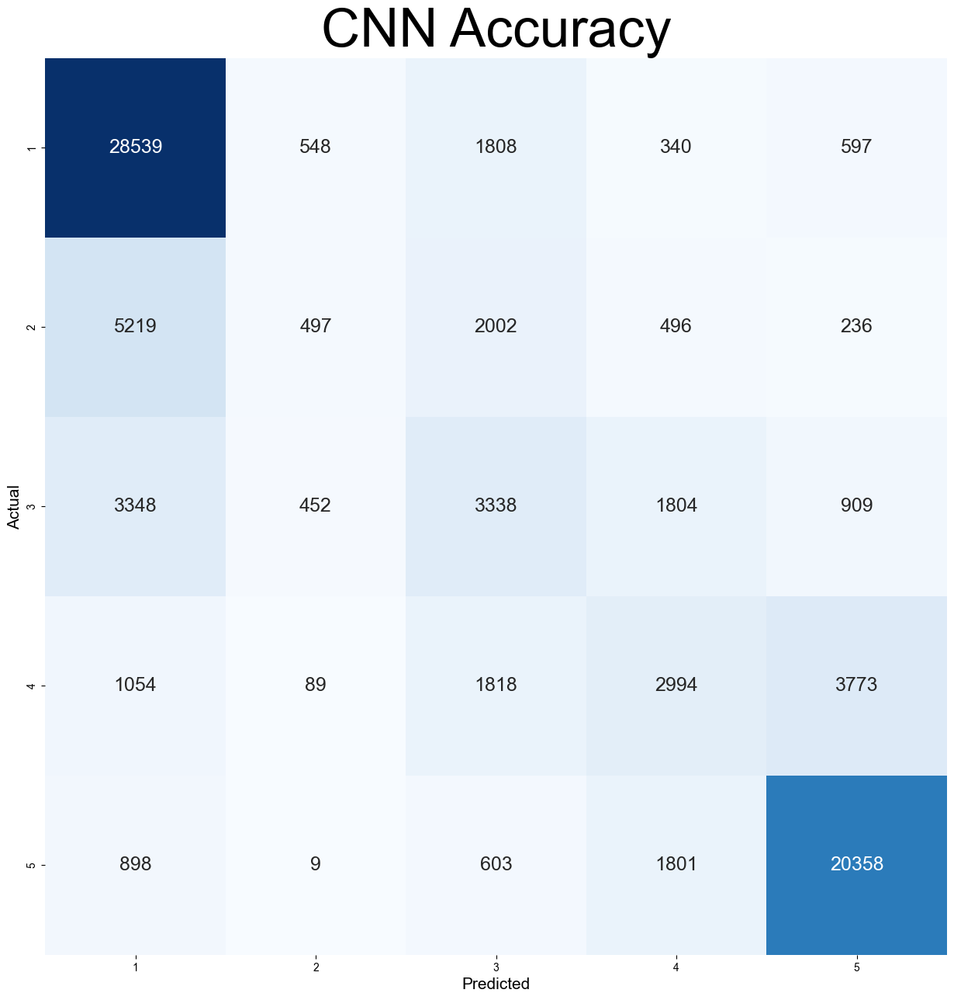

[[28539   548  1808   340   597]
 [ 5219   497  2002   496   236]
 [ 3348   452  3338  1804   909]
 [ 1054    89  1818  2994  3773]
 [  898     9   603  1801 20358]]


In [28]:
from sklearn.metrics import accuracy_score, confusion_matrix
import seaborn as sns
cnn_accuracy = accuracy_score(Y_test.argmax(axis=-1),ypred2.argmax(axis=-1))
print("CNN Accuracy:",cnn_accuracy)
cnn_cn = confusion_matrix(Y_test.argmax(axis=-1),ypred2.argmax(axis=-1))
plt.subplots(figsize=(15,15))
sns.set(font_scale=1.5)
sns.heatmap(cnn_cn,annot=True,fmt="g", cmap='Blues',cbar=False,xticklabels=le.classes_,yticklabels=le.classes_)
plt.title("CNN Accuracy",fontsize=50)
plt.xlabel("Predicted",fontsize=15)
plt.ylabel("Actual",fontsize=15)
plt.show()
print(cnn_cn )

In [29]:
from sklearn.metrics import precision_score,recall_score, confusion_matrix, classification_report,accuracy_score, f1_score
print('\n Clasification report:\n', classification_report(Y_test.argmax(axis=-1),ypred2.argmax(axis=-1), digits=4))


 Clasification report:
               precision    recall  f1-score   support

           0     0.7307    0.8966    0.8052     31832
           1     0.3116    0.0588    0.0990      8450
           2     0.3488    0.3388    0.3438      9851
           3     0.4027    0.3078    0.3489      9728
           4     0.7868    0.8601    0.8218     23669

    accuracy                         0.6671     83530
   macro avg     0.5161    0.4924    0.4837     83530
weighted avg     0.6210    0.6671    0.6309     83530



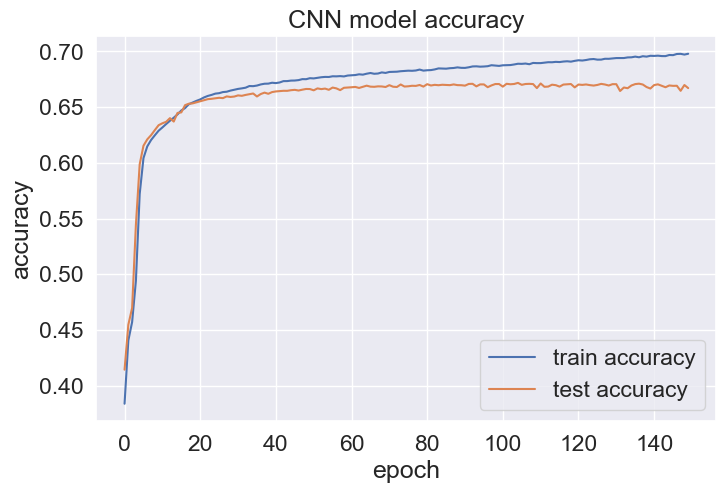

In [30]:
plt.figure(figsize=(8, 5))
ax = plt.axes()
ax.set_facecolor("#eaeaf2")
plt.plot(history.history['accuracy'],label="train accuracy")
plt.plot(history.history['val_accuracy'],label="test accuracy")
plt.title('CNN model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend()
plt.grid(color = 'w')
# plt.savefig('CNN_accuracy_CNN_relu-test',dpi=200); 
plt.show()


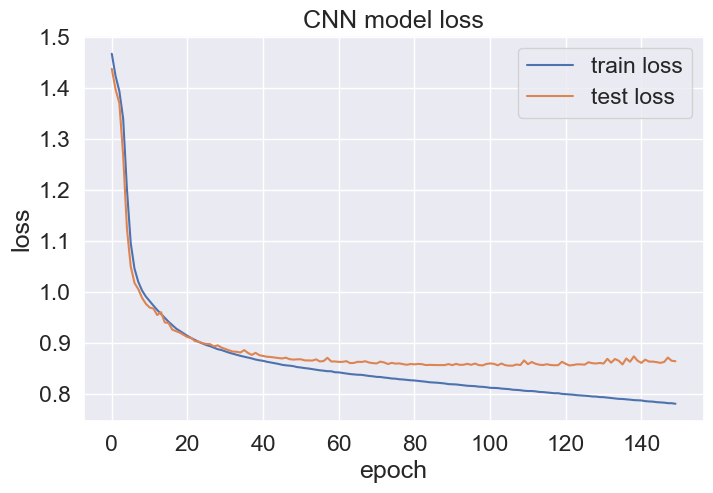

In [31]:
plt.figure(figsize=(8, 5))

ax = plt.axes()
ax.set_facecolor("#eaeaf2")
plt.plot(history.history['loss'],label="train loss")
plt.plot(history.history['val_loss'],label="test loss")
plt.title('CNN model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend()
plt.grid(color = 'w')
# plt.savefig('CNN_loss_CNN_relu-test',dpi=200); 
plt.show()

2611/2611 [==============================] - 12s 4ms/step


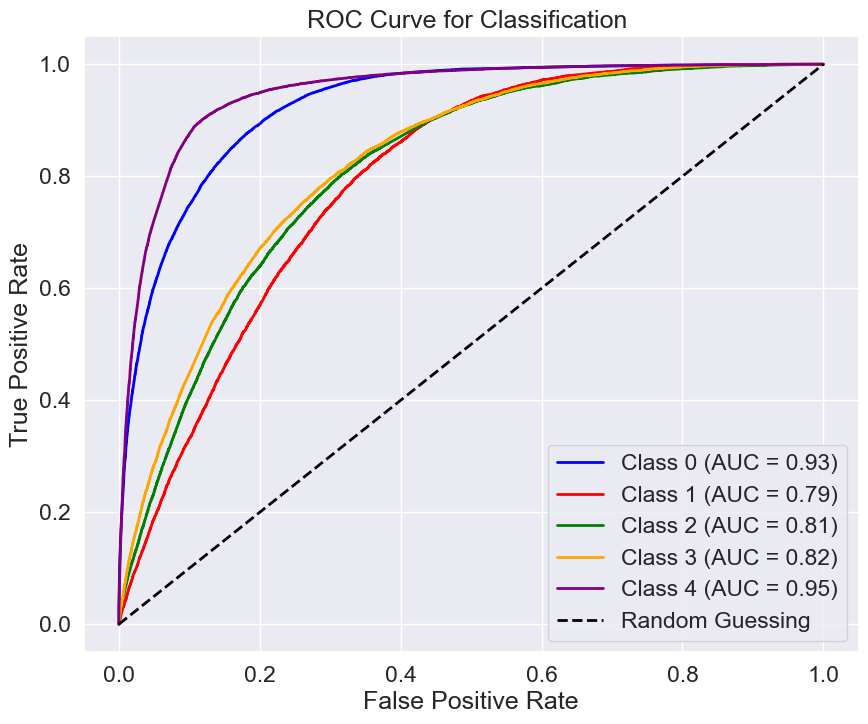

In [34]:
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_auc_score
from itertools import cycle


# Binarize the labels
# Assuming `y_test` contains the true labels for your test set
# Replace with your actual test labels
# y_test_bin = label_binarize(Y_test, classes=[1, 2, 3, 4, 5] )# Specify your class labels

y_true = Y_test  # Replace with your true labels
y_score = cnn_model.predict(X_test) # Replace with your predicted scores

y_true_binary = label_binarize(y_true, classes=[1, 2, 3, 4, 5])

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(5):
    fpr[i], tpr[i], _ = roc_curve(y_true_binary[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot ROC curve for each class
plt.figure(figsize=(10, 8))
colors = ['blue', 'red', 'green', 'orange', 'purple']  # Add more colors if you have more classes

for i, color in zip(range(5), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], color='black', lw=2, linestyle='--', label='Random Guessing')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Classification ')
plt.legend(loc='lower right')
plt.show()

In [33]:
#test#